In [ ]:
#Dependencies
#@title Import libraries
import os
import time
import tqdm
import torch
import IPython
import torchvision

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

from torchvision import transforms
from torchvision.models import AlexNet
from torchvision.utils import make_grid
from torchvision.datasets import ImageFolder

from PIL import Image
from io import BytesIO

import torch 
import torch.nn as nn
import torch.nn.functional as F 

import cv2 


In [ ]:
# title helper functions
def extract_subimg(im, rot_center, width, height, theta=0):
  rot_bbox = rotbbox_from_coords(rot_center, width, height, theta)

  subimg = im[rot_bbox[0,1]:rot_bbox[1,1],rot_bbox[0,0]:rot_bbox[1,0]]
  rotated_im = ndimage.rotate(subimg, np.degrees(theta)+180)
  newcenter = (np.array(rotated_im.shape)/2).astype(np.int)
  rotated_im = rotated_im[int(newcenter[0]-height/2):int(newcenter[0]+height/2), int(newcenter[1]-width/2):int(newcenter[1]+width/2), :3]  #drop alpha channel, if it's there

  return rotated_im

def extract_subimg_bbox(im, bbox):
  return extract_subimg(im, *unpack_bbox(bbox))

  rot_center = np.array((bbox[1], bbox[0])).T
  width = bbox[3]
  height = bbox[2]
  # theta = -bbox[4]+np.pi/2 #radians --> to include for oriented bounding boxes
  return rot_center, width, height
  #, theta


def rotcorners_from_coords(rot_center, width, height, theta=0):
  rotation = np.array(( (np.cos(theta), -np.sin(theta)),
               (np.sin(theta),  np.cos(theta)))) #--> for oriented bounding box

  wvec = np.dot(rotation, (width/2, 0))
  hvec = np.dot(rotation, (0, height/2))
  
  # There might be a problem
  # corner_points = rot_center + [wvec+hvec, wvec-hvec, -wvec+hvec, -wvec-hvec] #error point
  # corner_points = 
  return corner_points


def rotbbox_from_coords(rot_center, width, height, theta=0):
  corner_points = rotcorners_from_coords(rot_center, width, height, theta)
  rot_bbox = np.array((corner_points.min(0), corner_points.max(0))).astype(np.int)
  #constrain inside image
  rot_bbox[rot_bbox < 0] = 0

  return rot_bbox

def unpack_bbox(bbox):
  #bbox as in the json/COCO data format (centerx, centery, width, height, theta is in radians)
  return bbox

In [ ]:
#@title figure settings

import ipywidgets as widgets       # interactive display
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
plt.style.use("https://raw.githubusercontent.com/NeuromatchAcademy/content-creation/main/nma.mplstyle")

plt.rcParams["mpl_toolkits.legacy_colorbar"] = False
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")

from matplotlib import pyplot as plt
from matplotlib import rcParams, gridspec
from matplotlib import patches, transforms as plt_transforms

rcParams['figure.figsize'] = [16, 6]
rcParams['font.size'] =14
rcParams['axes.spines.top'] = False
rcParams['axes.spines.right'] = False
rcParams['figure.autolayout'] = True

In [ ]:
#@title set seed

In [ ]:
#@title set device

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


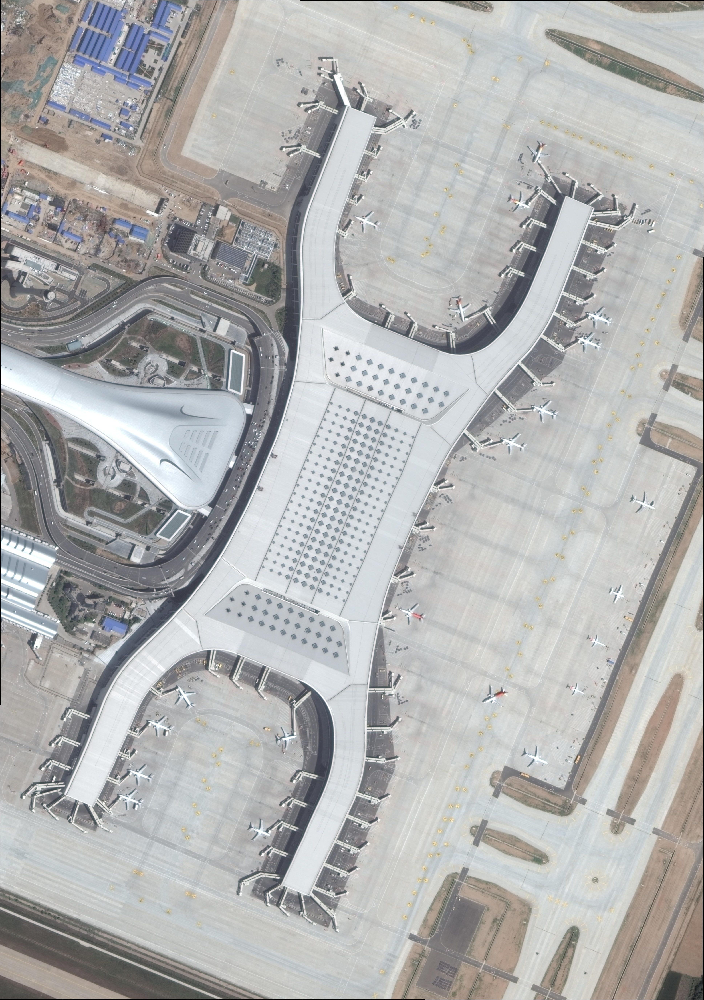

In [ ]:
#title downloading data

# if not os.path.exists('train_images/'):
#   os.mkdir('train_images/')

#opening an image and displaying!
# path = "/content/gdrive/MyDrive/datasets/efficient_dota/train/images/P0000.png"
path = "/content/gdrive/MyDrive/datasets/efficient_dota/train/P0000.png"



with open(path, 'rb') as my_img:

  img = Image.open(my_img)
  display(img)




In [ ]:
# Working
#Load the json file with the annotations

import json

# datapath = "/content/gdrive/MyDrive/datasets/efficient_dota/train"
datapath = "/content/gdrive/MyDrive/datasets/efficient_dota"
# with open(os.path.join(datapath, 'DOTA_1.0.json')) as f:
with open(os.path.join(datapath, 'annotations/train.json')) as f:
  data = json.load(f)

print(data.keys())
print(data['images'][1])
print(data['annotations'][1])
ann = data['annotations'][1]
print(ann['bbox'][3])

dict_keys(['info', 'images', 'categories', 'annotations'])
{'file_name': 'P0593.png', 'id': 2, 'width': 1434, 'height': 883}
{'area': 613.0, 'category_id': 6, 'segmentation': [[3445, 3391, 3484, 3409, 3478, 3422, 3437, 3402]], 'iscrowd': 0, 'bbox': [3437, 3391, 47, 31], 'image_id': 1, 'id': 2}
31


In [ ]:
#note: ran for 4mins and yes, it's working!

from skimage import io

#Load the images, and make some helpful dict to map the data
imgdir = os.path.join(datapath, 'train')

#remap images to dict by id
imgdict = {l['id']:l for l in data['images']}
#read in all images, can take some time
for i in imgdict.values():
  i['image'] = io.imread(os.path.join(imgdir, i['file_name']))[:, :,: 3]  # drop alpha channel, if it's there

# remap annotations to dict by image_id
from collections import defaultdict
annodict = defaultdict(list)
for annotation in data['annotations']:
  annodict[annotation['image_id']].append(annotation)

# setup list of categories
categories = data['categories']
ncategories = len(categories)
cat_ids = [i['id'] for i in categories]

category_names = {1:'plane',2:'ship',3:'storage tank',4:'baseball diamond',
                  5:'tennis court',6:'basketball court',7: 'ground track field',
                  8:'harbor',9:'bridge',10:'large vehicle',11:'small vehicle',
                  12:'helicopter',13:'roundabout',14:'soccer ball field',
                  15:'swimming pool'}

##Be carefull here


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/usr/local/lib/python3.7/dist-packages/IPython/core/pylabtools.py:125: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


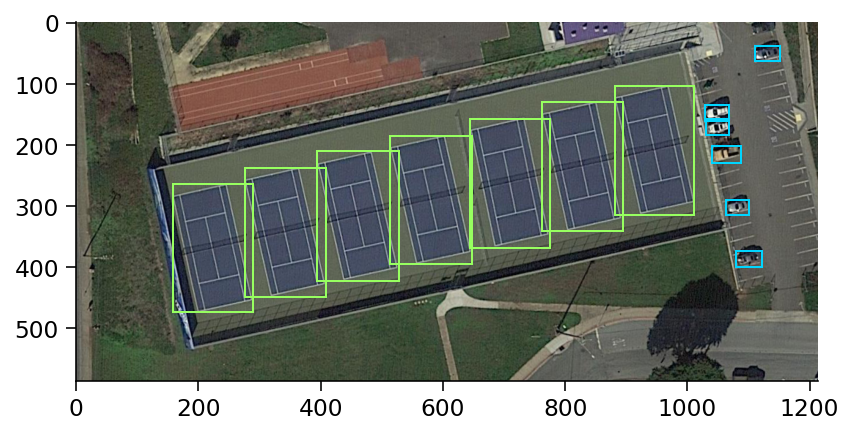

In [ ]:
# Let's look at one image and it's associated annotations

imageid = 74 #<-- Change to show different image with bounding box
im = imgdict[imageid]['image']

#A grid layout to place subplots within a figure.
gs = gridspec.GridSpec(1, 1 + len(annodict[imageid]),
                       width_ratios=[1,]+[.1]*len(annodict[imageid]),
                       wspace=.05)


plt.figure()
ax = plt.subplot(gs[0])
plt.imshow(im)


cmap_normal = plt.Normalize(0, ncategories)

legendList = []

for i, annotation in enumerate(annodict[imageid]):
  bbox = annotation['bbox']

  ax = plt.subplot(gs[0])
  
  color = plt.cm.jet(cmap_normal(annotation['category_id']))
  
  # color_patch = patches.Patch(color, label='annotation['category_id']')
  # ax.legend(handles=[red_patch])

  legendList.append((color,annotation['category_id']))



  rect=patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],  linewidth=1, edgecolor=color, facecolor='none')
  
 
  ax.add_patch(rect)
  
  '''add elgend corresponding to bbox color and category of obj'''

plt.show()


# YOLOv3 MODEL Architecture

In [ ]:
!git clone https://github.com/eriklindernoren/PyTorch-YOLOv3.git

fatal: destination path 'PyTorch-YOLOv3' already exists and is not an empty directory.


In [ ]:
#necessay imports for setting up model

from __future__ import division

import torch 
import torch.nn as nn
import torch.nn.functional as F 
from torch.autograd import Variable
import numpy as np

In [ ]:
def parse_cfg(cfgfile):
    """
    Takes a configuration file
    
    Returns a list of blocks. Each blocks describes a block in the neural
    network to be built. Block is represented as a dictionary in the list
    
    """
    
    file = open(cfgfile, 'r')
    lines = file.read().split('\n')                        # store the lines in a list
    lines = [x for x in lines if len(x) > 0]               # get read of the empty lines 
    lines = [x for x in lines if x[0] != '#']              # get rid of comments
    lines = [x.rstrip().lstrip() for x in lines]           # get rid of fringe whitespaces
    
    block = {}
    blocks = []
    
    for line in lines:
        if line[0] == "[":               # This marks the start of a new block
            if len(block) != 0:          # If block is not empty, implies it is storing values of previous block.
                blocks.append(block)     # add it the blocks list
                block = {}               # re-init the block
            block["type"] = line[1:-1].rstrip()     
        else:
            key,value = line.split("=") 
            block[key.rstrip()] = value.lstrip()
    blocks.append(block)
    
    return blocks

In [ ]:
#to check parse_cfg
config_file = "/content/gdrive/MyDrive/PyTorch-YOLOv3/config/yolov3-tiny.cfg"
# print(type(parse_cfg(config_file)))
parse_cfg(config_file)


[{'angle': '0',
  'batch': '64',
  'burn_in': '1000',
  'channels': '3',
  'decay': '0.0005',
  'exposure': '1.5',
  'height': '416',
  'hue': '.1',
  'learning_rate': '0.0001',
  'max_batches': '500200',
  'momentum': '0.9',
  'policy': 'steps',
  'saturation': '1.5',
  'scales': '.1,.1',
  'steps': '400000,450000',
  'subdivisions': '2',
  'type': 'net',
  'width': '416'},
 {'activation': 'leaky',
  'batch_normalize': '1',
  'filters': '16',
  'pad': '1',
  'size': '3',
  'stride': '1',
  'type': 'convolutional'},
 {'size': '2', 'stride': '2', 'type': 'maxpool'},
 {'activation': 'leaky',
  'batch_normalize': '1',
  'filters': '32',
  'pad': '1',
  'size': '3',
  'stride': '1',
  'type': 'convolutional'},
 {'size': '2', 'stride': '2', 'type': 'maxpool'},
 {'activation': 'leaky',
  'batch_normalize': '1',
  'filters': '64',
  'pad': '1',
  'size': '3',
  'stride': '1',
  'type': 'convolutional'},
 {'size': '2', 'stride': '2', 'type': 'maxpool'},
 {'activation': 'leaky',
  'batch_normal

In [ ]:
#We have 5 types of layers in the model architecture. 
#PyTorch provides pre-built layers for types convolutional and upsample.  
#We will have to write our own class modules for the rest of the layers by extending the nn.Module class.
#we subclass nn.Module and write the operation the layer performs in the forward function of the nn.Module object.
#we define for empty layer, detection layer(the detection layer)

class DetectionLayer(nn.Module):
  #anchors: holds the anchors used to detect bounding boxes
  def __init__(self, anchors):
    super(DetectionLayer, self).__init__()
    self.anchors = anchors
  
  #?why do we do this forward for the layer?
  def forward():
    pass

class EmptyLayer(nn.Module):
  def __init__(self):
    super(EmptyLayer, self).__init__()

  #?
  def forward():
    pass

In [ ]:

#defining the func that sets up all the blocks and layers

def create_modules(blocks):
    net_info = blocks[0]     #Captures the information about the input and pre-processing    
    module_list = nn.ModuleList()
    prev_filters = 3
    output_filters = []
    
    for index, x in enumerate(blocks[1:]):
        module = nn.Sequential()
    
        #check the type of block
        #create a new module for the block
        #append to module_list
        
        #If it's a convolutional layer
        if (x["type"] == "convolutional"):
            #Get the info about the layer
            activation = x["activation"]
            try:
                batch_normalize = int(x["batch_normalize"])
                bias = False
            except:
                batch_normalize = 0
                bias = True
        
            filters= int(x["filters"])
            padding = int(x["pad"])
            kernel_size = int(x["size"])
            stride = int(x["stride"])
        
            if padding:
                pad = (kernel_size - 1) // 2
            else:
                pad = 0
        
            #Add the convolutional layer
            conv = nn.Conv2d(prev_filters, filters, kernel_size, stride, pad, bias = bias)
            module.add_module("conv_{0}".format(index), conv)
        
            #Add the Batch Norm Layer
            if batch_normalize:
                bn = nn.BatchNorm2d(filters)
                module.add_module("batch_norm_{0}".format(index), bn)
        
            #Check the activation. 
            #It is either Linear or a Leaky ReLU for YOLO
            if activation == "leaky":
                activn = nn.LeakyReLU(0.1, inplace = True)
                module.add_module("leaky_{0}".format(index), activn)
        
            #If it's an upsampling layer
            #We use Bilinear2dUpsampling
        elif (x["type"] == "upsample"):
            stride = int(x["stride"])
            upsample = nn.Upsample(scale_factor = 2, mode = "nearest")
            module.add_module("upsample_{}".format(index), upsample)
                
        #If it is a route layer
        elif (x["type"] == "route"):
            x["layers"] = x["layers"].split(',')
            #Start  of a route
            start = int(x["layers"][0])
            #end, if there exists one.
            try:
                end = int(x["layers"][1])
            except:
                end = 0
            #Positive anotation
            if start > 0: 
                start = start - index
            if end > 0:
                end = end - index
            route = EmptyLayer()
            module.add_module("route_{0}".format(index), route)
            if end < 0:
                filters = output_filters[index + start] + output_filters[index + end]
            else:
                filters= output_filters[index + start]
    
        #shortcut corresponds to skip connection
        elif x["type"] == "shortcut":
            shortcut = EmptyLayer()
            module.add_module("shortcut_{}".format(index), shortcut)
            
        #Yolo is the detection layer
        elif x["type"] == "yolo":
            mask = x["mask"].split(",")
            mask = [int(x) for x in mask]
    
            anchors = x["anchors"].split(",")
            anchors = [int(a) for a in anchors]
            anchors = [(anchors[i], anchors[i+1]) for i in range(0, len(anchors),2)]
            anchors = [anchors[i] for i in mask]
    
            detection = DetectionLayer(anchors)
            module.add_module("Detection_{}".format(index), detection)
                              
        module_list.append(module)
        prev_filters = filters
        output_filters.append(filters)
        
    return (net_info, module_list)


In [ ]:
config_file = "/content/gdrive/MyDrive/PyTorch-YOLOv3/config/yolov3-tiny.cfg"
blocks = parse_cfg(config_file)
create_modules(blocks)

({'angle': '0',
  'batch': '64',
  'burn_in': '1000',
  'channels': '3',
  'decay': '0.0005',
  'exposure': '1.5',
  'height': '416',
  'hue': '.1',
  'learning_rate': '0.0001',
  'max_batches': '500200',
  'momentum': '0.9',
  'policy': 'steps',
  'saturation': '1.5',
  'scales': '.1,.1',
  'steps': '400000,450000',
  'subdivisions': '2',
  'type': 'net',
  'width': '416'},
 ModuleList(
   (0): Sequential(
     (conv_0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (batch_norm_0): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (leaky_0): LeakyReLU(negative_slope=0.1, inplace=True)
   )
   (1): Sequential()
   (2): Sequential(
     (conv_2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (batch_norm_2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (leaky_2): LeakyReLU(negative_slope=0.1, inplace=True)
   )
   (3): Sequential()
   (4): Se

In [ ]:

def get_test_input():
    img = cv2.imread("/content/PyTorch-YOLOv3/dog-cycle-car.png")
    plt.imshow(img)
    img = cv2.resize(img, (416,416))          #Resize to the input dimension
    img_ =  img[:,:,::-1].transpose((2,0,1))  # BGR -> RGB | H X W C -> C X H X W 
    img_ = img_[np.newaxis,:,:,:]/255.0       #Add a channel at 0 (for batch) | Normalise
    img_ = torch.from_numpy(img_).float()     #Convert to float
    img_ = Variable(img_)                     # Convert to Variable
    return img_

#DarkNet Backbone
class Darknet(nn.Module):
    def __init__(self, cfgfile):
        super(Darknet, self).__init__()
        self.blocks = parse_cfg(cfgfile)
        self.net_info, self.module_list = create_modules(self.blocks)
        self.header = torch.IntTensor([0,0,0,0])
        self.seen = 0

        
        
    def get_blocks(self):
        return self.blocks
    
    def get_module_list(self):
        return self.module_list

                
    def forward(self, x, CUDA):
        detections = []
        modules = self.blocks[1:]
        outputs = {}   #We cache the outputs for the route layer
        
        
        write = 0
        for i in range(len(modules)):        
            
            module_type = (modules[i]["type"])
            if module_type == "convolutional" or module_type == "upsample" or module_type == "maxpool":
                
                x = self.module_list[i](x)
                if CUDA:
                  x=x.cuda()
                outputs[i] = x

                
            elif module_type == "route":
                layers = modules[i]["layers"]
                layers = [int(a) for a in layers]
                
                if (layers[0]) > 0:
                    layers[0] = layers[0] - i

                if len(layers) == 1:
                  if CUDA:
                   x=x.cuda()

                  x = outputs[i + (layers[0])]

                else:
                    if (layers[1]) > 0:
                        layers[1] = layers[1] - i
                        
                    map1 = outputs[i + layers[0]]
                    map2 = outputs[i + layers[1]]
                    
                    print("TYPE  ",type(map2))
                    map2=F.interpolate(map2,416)
                    map1=F.interpolate(map1,416)
                    x = torch.cat((map1, map2), 1)

                    if CUDA:
                     x=x.cuda()

                    outputs[i] = x
            
            elif  module_type == "shortcut":
                from_ = int(modules[i]["from"])
                x = outputs[i-1] + outputs[i+from_]
                if CUDA:
                     x=x.cuda()
                outputs[i] = x
            
            elif module_type == 'yolo':        
                
                anchors = self.module_list[i][0].anchors
                #Get the input dimensions
                inp_dim = int (self.net_info["height"])
                
                #Get the number of classes
                num_classes = int (modules[i]["classes"])
                
                #Output the result
                x = x.data
                x = predict_transform(x, inp_dim, anchors, num_classes, CUDA)
                if CUDA:
                     x=x.cuda()                


                if type(x) == int:
                    continue

                
                if not write:
                    detections = x
                    write = 1
                
                else:
                    detections = torch.cat((detections, x), 1)
                
                outputs[i] = outputs[i-1]
        try:
            return detections
        except:
            return 0



In [ ]:
def predict_transform(prediction, inp_dim, anchors, num_classes, CUDA = True):

    batch_size = prediction.size(0)
    stride =  inp_dim // prediction.size(2)
    grid_size = inp_dim // stride
    bbox_attrs = 5 + num_classes
    num_anchors = len(anchors)
    
    prediction = prediction.view(batch_size, bbox_attrs*num_anchors, grid_size*grid_size)
    prediction = prediction.transpose(1,2).contiguous()
    prediction = prediction.view(batch_size, grid_size*grid_size*num_anchors, bbox_attrs)
    anchors = [(a[0]/stride, a[1]/stride) for a in anchors]

    #Sigmoid the  centre_X, centre_Y. and object confidencce
    prediction[:,:,0] = torch.sigmoid(prediction[:,:,0])
    prediction[:,:,1] = torch.sigmoid(prediction[:,:,1])
    prediction[:,:,4] = torch.sigmoid(prediction[:,:,4])
    
    #Add the center offsets
    grid = np.arange(grid_size)
    a,b = np.meshgrid(grid, grid)

    x_offset = torch.FloatTensor(a).view(-1,1)
    y_offset = torch.FloatTensor(b).view(-1,1)

    if CUDA:
        x_offset = x_offset.cuda()
        y_offset = y_offset.cuda()

    x_y_offset = torch.cat((x_offset, y_offset), 1).repeat(1,num_anchors).view(-1,2).unsqueeze(0)

    prediction[:,:,:2] += x_y_offset

    #log space transform height and the width
    anchors = torch.FloatTensor(anchors)

    if CUDA:
        anchors = anchors.cuda()

    anchors = anchors.repeat(grid_size*grid_size, 1).unsqueeze(0)
    prediction[:,:,2:4] = torch.exp(prediction[:,:,2:4])*anchors
    
    prediction[:,:,5: 5 + num_classes] = torch.sigmoid((prediction[:,:, 5 : 5 + num_classes]))

    prediction[:,:,:4] *= stride
    
    return prediction

In [ ]:
DEVICE="cuda"
model = Darknet("/content/gdrive/MyDrive/PyTorch-YOLOv3/config/yolov3-tiny.cfg")
inp = get_test_input()
pred = model(inp, 0)
# pred = model(inp, torch.cuda.is_available())

# print("PREDDD")
# print (pred)


In [ ]:
DEVICE="cuda"
CUDA = torch.cuda.is_available
model = Darknet("/content/gdrive/MyDrive/PyTorch-YOLOv3/config/yolov3-tiny.cfg").to(DEVICE)
# model = model.cuda()
# inp = get_test_input()
# pred = model(inp, CUDA)

if CUDA:
    model = model.cuda()
    inp = inp.cuda()
pred = model(inp, CUDA)
print (pred)


print (pred)
